In [1]:
import os
import json
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.font_manager as font_manager
import matplotlib.patches as mpatches
import seaborn as sns
from itertools import permutations
from sklearn.decomposition import PCA


np.random.seed(42)

%matplotlib inline
sns.set_context('poster')
sns.set_style('white')
sns.set_color_codes()
plot_kwds = {'alpha' : 0.5, 's' : 80, 'linewidths':0}

In [2]:
# Set data input folder
input_folder = "inputs"

# Set output folder, subfolder
output_folder = "outputs"
if not os.path.exists(output_folder):
    os.makedirs(output_folder, exist_ok=True)
if not os.path.exists(os.path.join(output_folder,"figure_panels")):
    os.makedirs(os.path.join(output_folder,"figure_panels"), exist_ok=True)

In [3]:
# load gene level profiles for each condition
conditions = ['A549','HeLa_DMEM','HeLa_HPLM']
df_input_files = {'A549':"../Profile_Aggregation/outputs/20200805_A549_WG_Screen_guide_normalized_feature_select_median_merged_ALLBATCHES___CP186___ALLWELLS_gene_aggregated.csv.gz",
           'HeLa_DMEM':"../Profile_Aggregation/outputs/20210422_6W_CP257_guide_normalized_feature_select_median_merged_ALLBATCHES___DMEM___ALLWELLS_gene_aggregated.csv.gz", 
           'HeLa_HPLM':"../Profile_Aggregation/outputs/20210422_6W_CP257_guide_normalized_feature_select_median_merged_ALLBATCHES___HPLM___ALLWELLS_gene_aggregated.csv.gz"}
df_genes_dict = {}
for condition in conditions:
    df_genes_dict[condition] = pd.read_csv(df_input_files[condition]).set_index('Metadata_Foci_Barcode_MatchedTo_GeneCode')
    

In [4]:
# load hit lists for each condition and subset the profile dataframes
whole_cell_hits_files = {'A549':"../2_A549_Screen_Summary/outputs/A549_plate_level_median_per_feat_sig_genes_1_FDR_whole_cell_hits.csv",
           'HeLa_DMEM':"../3_HeLa_Screens_Summary/outputs/HeLa_DMEM_plate_level_median_per_feat_sig_genes_1_FDR_whole_cell_hits.csv", 
           'HeLa_HPLM':"../3_HeLa_Screens_Summary/outputs/HeLa_HPLM_plate_level_median_per_feat_sig_genes_1_FDR_whole_cell_hits.csv"}

comp_spec_hits_files = {'A549':"../2_A549_Screen_Summary/outputs/A549_plate_level_median_per_feat_sig_genes_1_FDR_compartment_specific_hits.csv",
           'HeLa_DMEM':"../3_HeLa_Screens_Summary/outputs/HeLa_DMEM_plate_level_median_per_feat_sig_genes_1_FDR_compartment_specific_hits.csv", 
           'HeLa_HPLM':"../3_HeLa_Screens_Summary/outputs/HeLa_HPLM_plate_level_median_per_feat_sig_genes_1_FDR_compartment_specific_hits.csv"}

df_hits_dict = {}
for condition in conditions:
    whole_cell_hits = pd.read_csv(whole_cell_hits_files[condition]).set_index('Gene')
    comp_spec_hits = pd.read_csv(comp_spec_hits_files[condition]).set_index('Gene')
    hit_list = list(comp_spec_hits.index) + list(whole_cell_hits.index)
    df_hits_dict[condition] = df_genes_dict[condition].loc[df_genes_dict[condition].index.isin(hit_list)]


In [5]:
# Perform principal component analysis on gene aggregated profiles
df_hits_pca_dict = {}
for condition in conditions:
    pca = PCA(svd_solver='full')
    pca.fit(df_hits_dict[condition])
    x = list(pca.explained_variance_ratio_)
    # Find principal component that represents 90% variation
    PCA_lookup = {}
    for i in range(len(x)):
        distance = abs(.9-sum(x[:i+1]))
        PCA_lookup[distance] = i 
    component = PCA_lookup[min(PCA_lookup.keys())]+1
    print (f'For {condition}, principal component representing closest to 90% variation is {component}')
    # Perform principal component analysis and select components representing 90% of variation in data
    pca = PCA(n_components=component,svd_solver='full')
    df_hits_pca_dict[condition] = pd.DataFrame(pca.fit_transform(df_hits_dict[condition]),index=df_hits_dict[condition].index)


For A549, principal component representing closest to 90% variation is 334
For HeLa_DMEM, principal component representing closest to 90% variation is 325
For HeLa_HPLM, principal component representing closest to 90% variation is 231


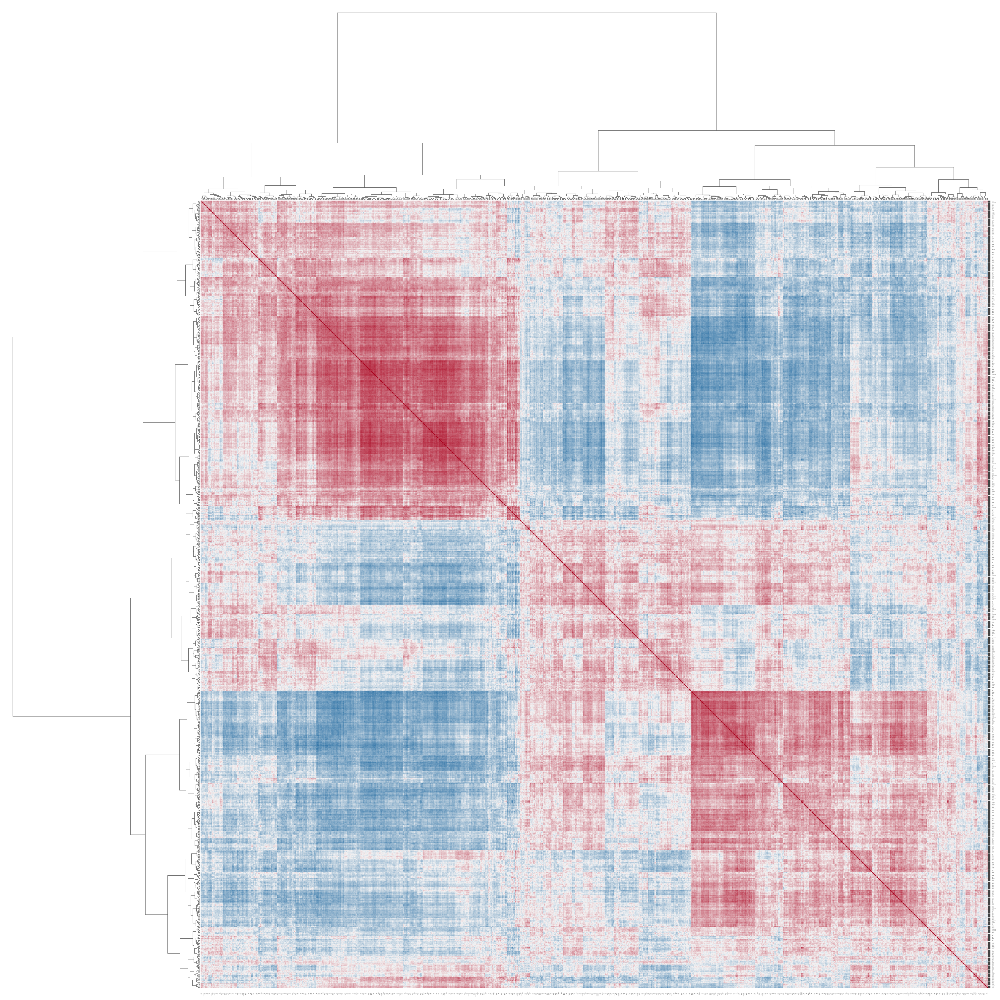

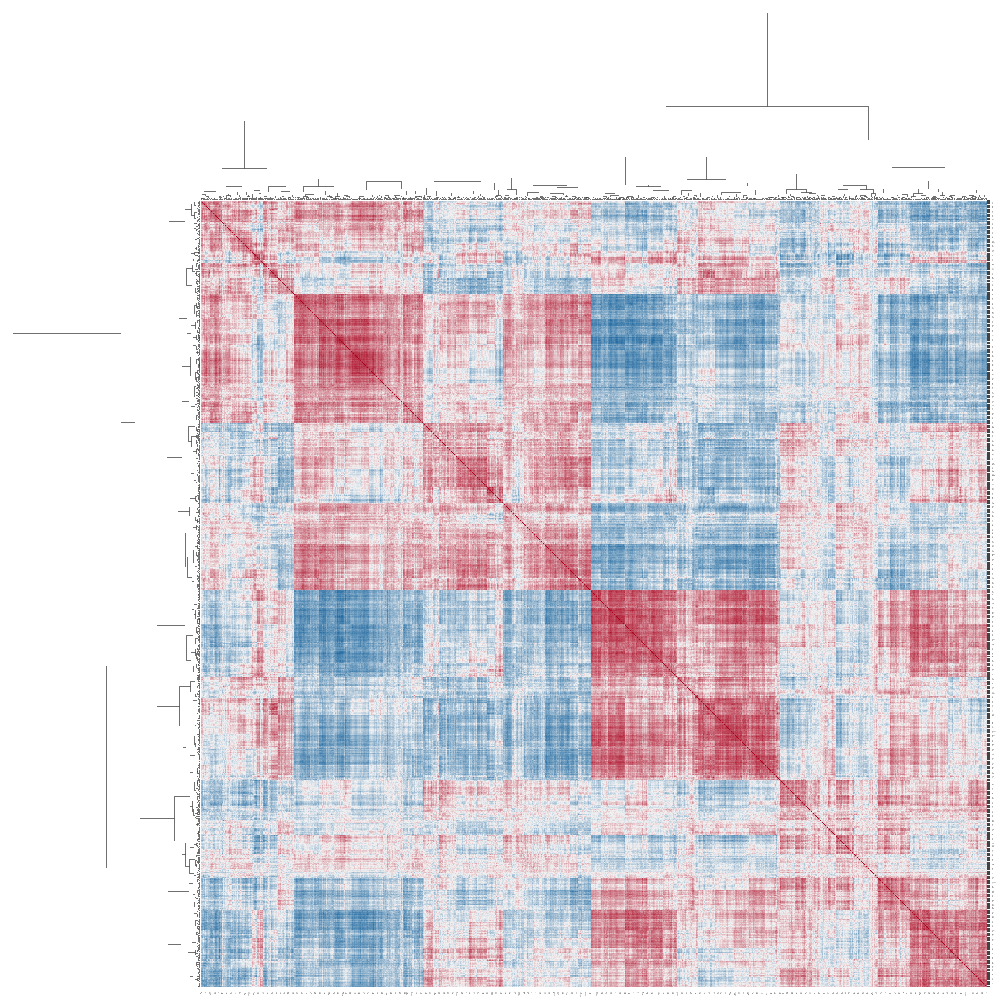

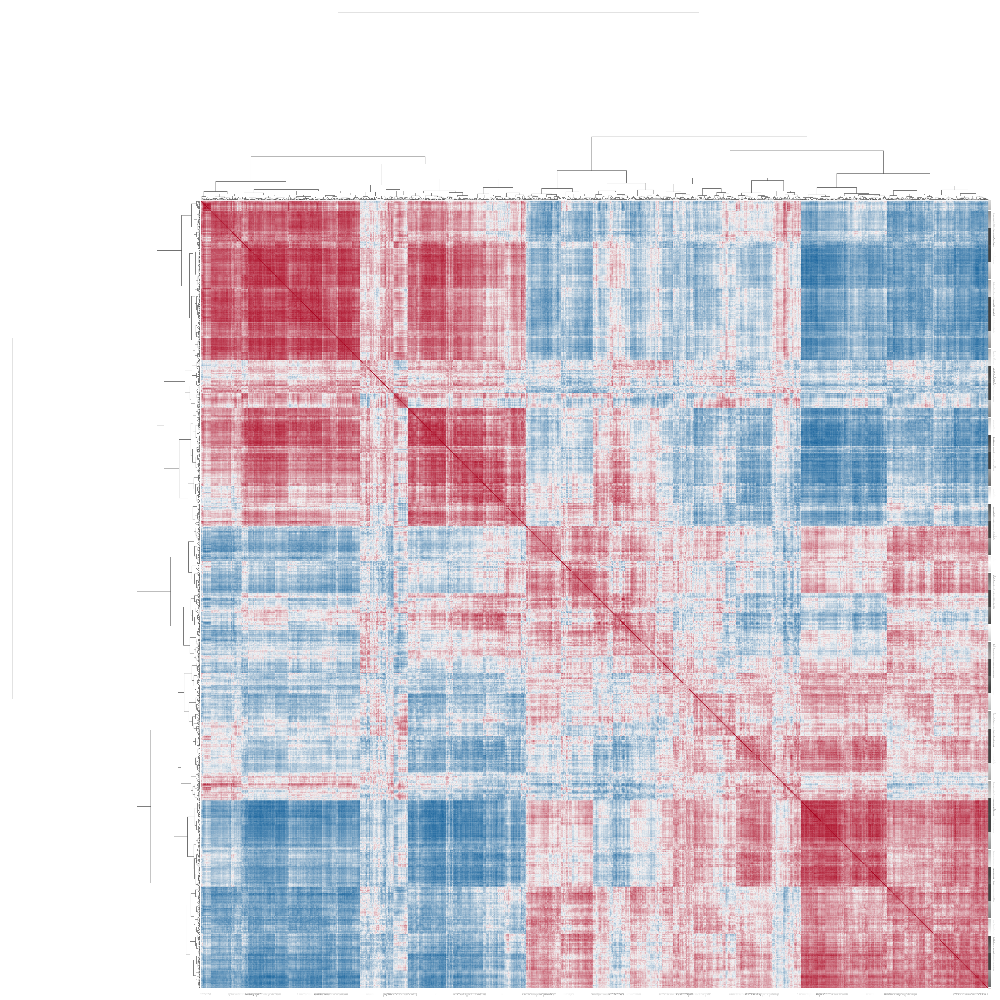

In [6]:
from scipy.spatial import distance
from scipy.cluster import hierarchy

# Calculate correlations, cluster and draw heatmap 
def clustered_heat_map(data,file_name,font_scale=0.8,linewidth=1):
        corr = data.corr()
        sns.set(font_scale=font_scale)
        correlations_array = np.asarray(corr)

        row_linkage = hierarchy.linkage(distance.pdist(correlations_array), method='ward')

        g = sns.clustermap(
            corr, 
            vmin=-1, vmax=1, center=0,
            row_linkage=row_linkage,
            col_linkage=row_linkage,
            figsize = (30 ,30),
            cmap=sns.diverging_palette(250, 10 ,s=100,l=35, n=100),
            linewidth = linewidth,
            linecolor='white',
            cbar=False,
            cbar_kws={"shrink": .76},
        )
        ax = g.ax_heatmap
        ax.set_xlabel("")
        ax.set_ylabel("")
        g.ax_row_dendrogram.set_visible(True)
        g.ax_col_dendrogram.set_visible(True)
        g.cax.set_visible(False)
        plt.tight_layout()
        output_file = os.path.join(f"{file_name}")
        plt.savefig(output_file,dpi=600) 
        plt.show()


for condition in conditions:
    clustered_heat_map(df_hits_pca_dict[condition].T,
                   os.path.join(output_folder,'figure_panels',f'{condition}_all_hits_heat_map.png'),
                   0.1,0)
